In [1]:
import os
os.environ["CUDA_VISIBLE_DEVICES"]="1"

In [2]:
import numpy as np
import torch
import scanpy as sc
import muon as mu
import anndata
import mudata
import pandas as pd

print(anndata.__version__)
print(mudata.__version__)
print(sc.__version__)
print(torch.__version__)

0.8.0
0.2.1
1.9.2
1.11.0


In [3]:
%load_ext autoreload
%autoreload 2

In [4]:
from src.types import TrainParams
from src.smvae.model import SMVAE, ModelParams
from src.smvae.train import train_smvae
from src.smvae.dataloader import *
from src.types import TrainParams
from src.smvae.diagnostics import plot_embedding, classification_performance

In [7]:
mdata = mu.read('/media/yob/nacho_stuff/prostate_cancer/Integration/MVAE-PoE/OtF-prostate/data/mdata_preprocessed_final_filtered.h5mu')
mdata

MuData object with n_obs × n_vars = 42475 × 31460
  obs:	'sample', 'tissue', 'patient', 'ann', 'imagerow', 'imagecol'
  2 modalities
    rna:	42475 x 18950
      obs:	'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'n_counts', 'n_genes', 'size_factors', 'sample', 'type', 'patient', 'ann', 'tissue', 'imagerow', 'imagecol'
      obsm:	'spatial'
      layers:	'counts', 'scran_normalization', 'spotclean'
    msi:	42475 x 12510
      obs:	'ST_barcode', 'sample', 'tissue', 'patient', 'ann', 'imagerow', 'imagecol'
      obsm:	'spatial'

In [9]:
metadata = mu.read('/media/yob/nacho_stuff/prostate_cancer/Integration/MVAE-PoE/OtF-prostate/data/mdata_metadata.h5mu')
mdata.obs["new_ann"] = metadata.obs["new_ann"]
mdata.mod["msi"].obs["new_ann"] = metadata.obs["new_ann"]
mdata.mod["rna"].obs["new_ann"] = metadata.obs["new_ann"]

## VAE with LISI (0.5 * private)

In [10]:
train_params = TrainParams(train_size=0.8, n_epochs=100, learning_rate=1e-4, batch_size=128, params_file="smvae_prostate")
model_params = ModelParams(beta=0.01, n_layers=2, z_dim=100, n_hidden=30, use_cuda=True)
torch.set_num_threads(16)
model = SMVAE(mdata, model_params)

(42475, 18950)
(42475, 12510)


In [11]:
from src.smvae.train import train_smvae

# train_smvae(model, mdata, "sample", train_params)
model.load_state_dict(torch.load("mvae_params/smvae_prostate_20230424-170539.pt"))

<All keys matched successfully>

100%|██████████████████████████████████████████████████████████████████████| 332/332 [00:37<00:00,  8.88it/s]
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


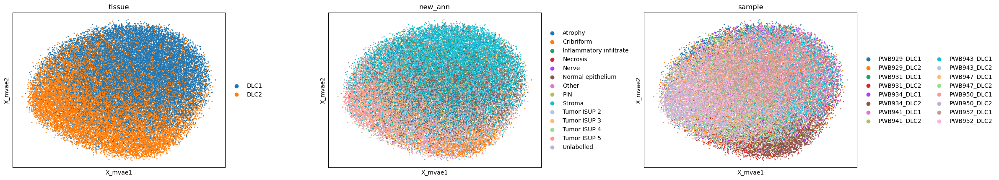

In [12]:
plot_embedding(model, mdata, train_params=train_params, keys=["tissue", "new_ann", "sample"], poe_only=False)

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


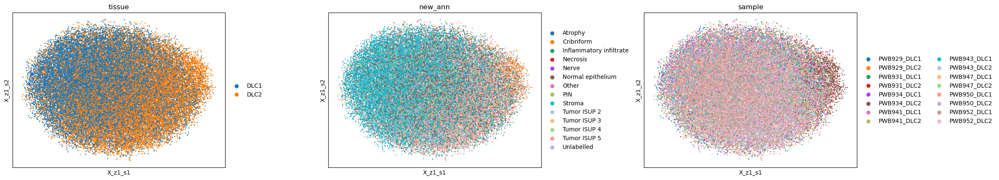

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


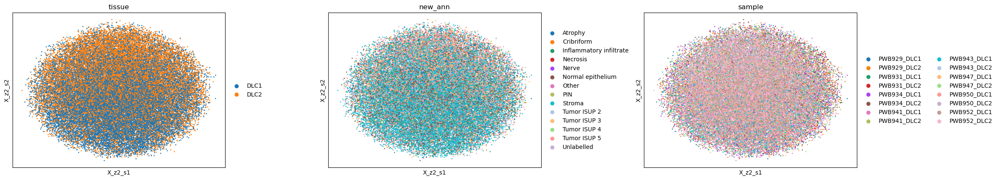

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


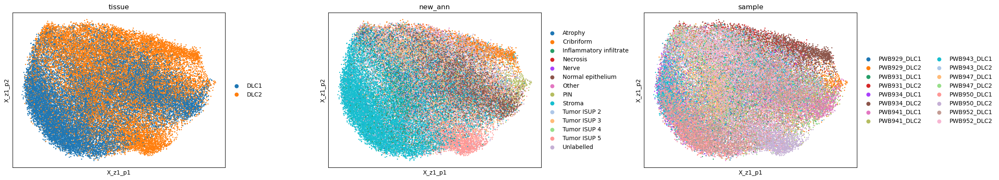

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


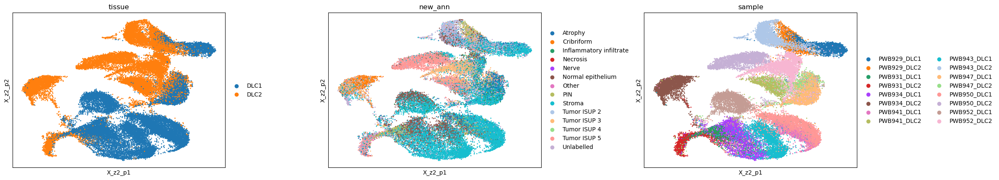

In [14]:
for layer in ["X_z1_s", "X_z2_s", "X_z1_p", "X_z2_p"]:
    sc.pl.embedding(
            mdata,
            layer,
            color=["tissue", "new_ann", "sample"],
            size=15,
            wspace=0.35,
        )

In [16]:
# class_perf = {}
# for sample in mdata.obs["sample"].unique():
#     class_perf[sample] = classification_performance(mdata, loo=sample, label_key="new_ann")[0]
class_perf

{'PWB929_DLC2': 0.1401174168297456,
 'PWB929_DLC1': 0.45113168724279834,
 'PWB931_DLC2': 0.1987353206865402,
 'PWB931_DLC1': 0.3439024390243902,
 'PWB934_DLC2': 0.11045169798878998,
 'PWB934_DLC1': 0.513009540329575,
 'PWB941_DLC2': 0.16864244741873805,
 'PWB941_DLC1': 0.4147375285295077,
 'PWB943_DLC2': 0.17028380634390652,
 'PWB943_DLC1': 0.4998410174880763,
 'PWB947_DLC2': 0.22535787321063394,
 'PWB947_DLC1': 0.3602455146364495,
 'PWB950_DLC2': 0.10227272727272728,
 'PWB950_DLC1': 0.5312275664034458,
 'PWB952_DLC2': 0.17174515235457063,
 'PWB952_DLC1': 0.40306300034806825}

/tmp/ipykernel_2140557/2601584028.py:6: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(labels=ax.get_xticklabels(), rotation=90)


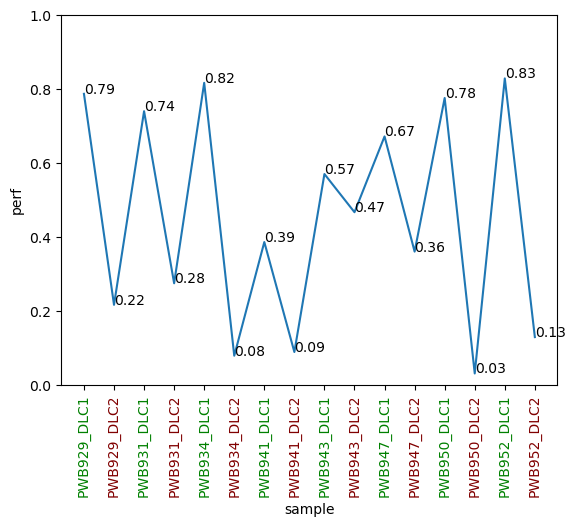

In [114]:
import seaborn as sns
cp = pd.DataFrame({"perf": class_perf.values(), "sample": class_perf.keys()}).sort_values("sample")
cp["tissue"] = ["normal", "cancer"] * int(len(cp) / 2)
ax = sns.lineplot(x="sample", y="perf", data=cp, markers=True)

ax.set_xticklabels(labels=ax.get_xticklabels(), rotation=90)
for tissue, tick_label in zip(cp["tissue"], ax.axes.get_xticklabels()):
    if tissue == "cancer":
        tick_label.set_color("maroon")
    else:
        tick_label.set_color("green")
        
ax.set(ylim=(0, 1))

for x,y in cp[['sample','perf']].values:
    ax.text(x, y, str(round(y, 2)))

## VAE with LISI calculated on private layers

In [166]:
train_params = TrainParams(train_size=0.8, n_epochs=100, learning_rate=1e-4, batch_size=128, params_file="smvae_prostate_lisi_p")
model_params = ModelParams(beta=0.01, n_layers=2, z_dim=100, n_hidden=30, use_cuda=True)
torch.set_num_threads(16)
model = SMVAE(mdata, model_params)

(42475, 18950)
(42475, 12510)


In [167]:
from src.smvae.train import train_smvae
# train_smvae(model, mdata, "sample", train_params)
model.load_state_dict(torch.load("mvae_params/smvae_prostate_lisi_p_20230425-000848.pt"))


<All keys matched successfully>

100%|██████████████████████████████████████████████████████████████████████| 332/332 [00:30<00:00, 10.89it/s]
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


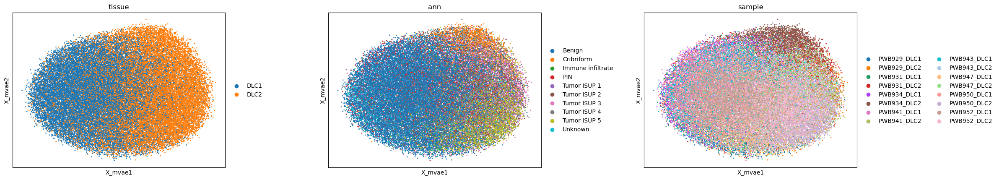

In [168]:
plot_embedding(model, mdata, train_params=train_params, poe_only=False)

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


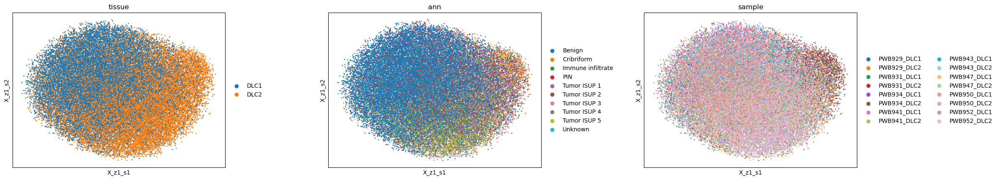

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


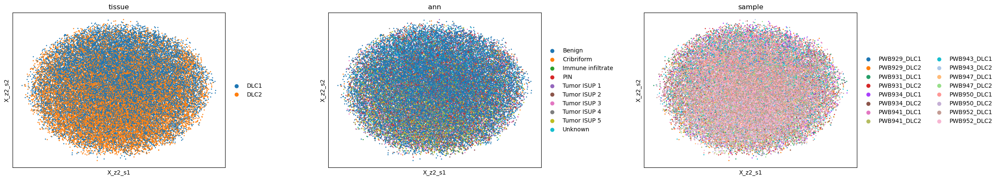

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


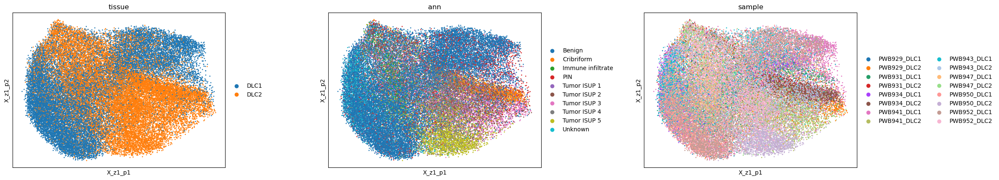

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


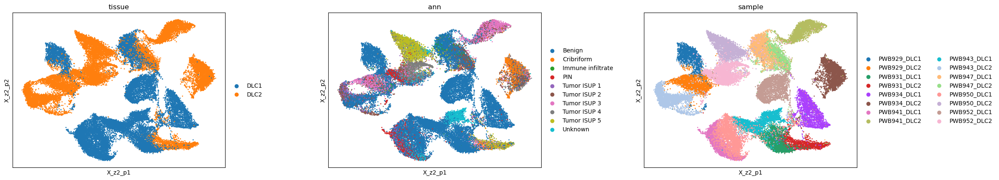

In [148]:
for layer in ["X_z1_s", "X_z2_s", "X_z1_p", "X_z2_p"]:
    sc.pl.embedding(
            mdata,
            layer,
            color=["tissue", "ann", "sample"],
            size=15,
            wspace=0.35,
        )

In [169]:
class_perf = {}
for sample in mdata.obs["sample"].unique():
    class_perf[sample] = classification_performance(mdata, loo=sample, embed_key="X_z1_p")[0]
class_perf

{'PWB929_DLC2': 0.25870841487279844,
 'PWB929_DLC1': 0.8544238683127572,
 'PWB931_DLC2': 0.3062330623306233,
 'PWB931_DLC1': 0.7302439024390244,
 'PWB934_DLC2': 0.10913287174414771,
 'PWB934_DLC1': 0.8633998265394622,
 'PWB941_DLC2': 0.12504780114722752,
 'PWB941_DLC1': 0.3524616889468536,
 'PWB943_DLC2': 0.47111853088480804,
 'PWB943_DLC1': 0.5809220985691574,
 'PWB947_DLC2': 0.3554192229038855,
 'PWB947_DLC1': 0.7568460812086875,
 'PWB950_DLC2': 0.019805194805194805,
 'PWB950_DLC1': 0.8061737257717158,
 'PWB952_DLC2': 0.13665743305632502,
 'PWB952_DLC1': 0.8381482770623042}

## VAE with LISI calculated on MSI private layer

In [152]:
train_params = TrainParams(train_size=0.8, n_epochs=100, learning_rate=1e-4, batch_size=128, params_file="smvae_prostate_lisi_p_msi")
model_params = ModelParams(beta=0.01, n_layers=2, z_dim=100, n_hidden=30, use_cuda=True)
torch.set_num_threads(16)
model = SMVAE(mdata, model_params)

(42475, 18950)
(42475, 12510)


In [153]:
from src.smvae.train import train_smvae

train_smvae(model, mdata, "sample", train_params)

Train data size: 33980
Test data size: 8495


100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:47<00:00,  1.59it/s]

EarlyStopping (epoch: 1): train loss improved to 0.14032636982612992



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:39<00:00,  1.68it/s]

EarlyStopping (epoch: 1): valid loss improved to 15.681708478215915



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:47<00:00,  1.59it/s]

EarlyStopping (epoch: 2): train loss improved to 0.11248761859622122



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:39<00:00,  1.68it/s]

EarlyStopping (epoch: 2): valid loss improved to 11.643110118695159



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:45<00:00,  1.61it/s]

EarlyStopping (epoch: 3): train loss improved to 0.08165987774229808



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:39<00:00,  1.70it/s]

EarlyStopping (epoch: 3): valid loss improved to 8.391373961719115



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:44<00:00,  1.62it/s]

EarlyStopping (epoch: 4): train loss improved to 0.058700304272737557



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:39<00:00,  1.71it/s]

EarlyStopping (epoch: 4): valid loss improved to 6.42729720784657



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:45<00:00,  1.61it/s]

EarlyStopping (epoch: 5): train loss improved to 0.04633289100563898



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:39<00:00,  1.70it/s]

EarlyStopping (epoch: 5): valid loss improved to 5.230047524864994



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:39<00:00,  1.72it/s]

EarlyStopping (epoch: 6): valid loss improved to 4.52567175964811



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:45<00:00,  1.61it/s]

EarlyStopping (epoch: 7): train loss improved to 0.0353881721569553



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:39<00:00,  1.69it/s]

EarlyStopping (epoch: 7): valid loss improved to 4.131825607214401



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:38<00:00,  1.72it/s]

EarlyStopping (epoch: 8): valid loss improved to 3.9154950220193436



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:39<00:00,  1.72it/s]

EarlyStopping (epoch: 9): valid loss improved to 3.7824026933356896



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:39<00:00,  1.69it/s]

EarlyStopping (epoch: 10): valid loss improved to 3.6993042924510897



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:39<00:00,  1.70it/s]

EarlyStopping (epoch: 11): valid loss improved to 3.634185858626864



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:39<00:00,  1.69it/s]

EarlyStopping (epoch: 12): valid loss improved to 3.581287508580222



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:39<00:00,  1.71it/s]

EarlyStopping (epoch: 13): valid loss improved to 3.5396769153538035



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:39<00:00,  1.69it/s]

EarlyStopping (epoch: 14): valid loss improved to 3.4957480857621377



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:39<00:00,  1.71it/s]

EarlyStopping (epoch: 15): valid loss improved to 3.4510655830155557



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:39<00:00,  1.70it/s]

EarlyStopping (epoch: 16): valid loss improved to 3.4090749221061594



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:46<00:00,  1.60it/s]

EarlyStopping (epoch: 17): train loss hasn't improved: 0.028209975910860347. Stopping.



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:39<00:00,  1.69it/s]

EarlyStopping (epoch: 17): valid loss improved to 3.3726837635040283



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:46<00:00,  1.59it/s]

EarlyStopping (epoch: 18): train loss hasn't improved: 0.0279060237684132. Stopping.



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:39<00:00,  1.69it/s]

EarlyStopping (epoch: 18): valid loss improved to 3.3279824399236424



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:47<00:00,  1.59it/s]

EarlyStopping (epoch: 19): train loss hasn't improved: 0.02758225376568099. Stopping.



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:39<00:00,  1.70it/s]

EarlyStopping (epoch: 19): valid loss improved to 3.3028343862562037



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:47<00:00,  1.59it/s]

EarlyStopping (epoch: 20): train loss hasn't improved: 0.027333290826720025. Stopping.



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:39<00:00,  1.69it/s]

EarlyStopping (epoch: 20): valid loss improved to 3.269475250101801



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:47<00:00,  1.59it/s]

EarlyStopping (epoch: 21): train loss hasn't improved: 0.027133259056174384. Stopping.



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:40<00:00,  1.67it/s]

EarlyStopping (epoch: 21): valid loss improved to 3.2378204046790278



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:46<00:00,  1.60it/s]

EarlyStopping (epoch: 22): train loss hasn't improved: 0.026892878238841882. Stopping.



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:39<00:00,  1.68it/s]

EarlyStopping (epoch: 22): valid loss improved to 3.2110960625890477



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:47<00:00,  1.59it/s]

EarlyStopping (epoch: 23): train loss hasn't improved: 0.02671931329511628. Stopping.



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:39<00:00,  1.70it/s]

EarlyStopping (epoch: 23): valid loss improved to 3.1771965525043546



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:46<00:00,  1.60it/s]

EarlyStopping (epoch: 24): train loss hasn't improved: 0.026500472073838457. Stopping.



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:40<00:00,  1.66it/s]

EarlyStopping (epoch: 24): valid loss improved to 3.1568778415224443



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:46<00:00,  1.60it/s]

EarlyStopping (epoch: 25): train loss hasn't improved: 0.0263203799198346. Stopping.



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:39<00:00,  1.71it/s]

EarlyStopping (epoch: 25): valid loss improved to 3.124315240489903



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:46<00:00,  1.60it/s]

EarlyStopping (epoch: 26): train loss hasn't improved: 0.026122526886745226. Stopping.



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:40<00:00,  1.66it/s]

EarlyStopping (epoch: 26): valid loss improved to 3.0987763974203992



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:47<00:00,  1.59it/s]

EarlyStopping (epoch: 27): train loss hasn't improved: 0.02594162979990402. Stopping.



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:39<00:00,  1.68it/s]

EarlyStopping (epoch: 27): valid loss improved to 3.072570619298451



 80%|████████████████████████████████████████████████████████              | 213/266 [02:15<00:33,  1.57it/s]


KeyboardInterrupt: 

100%|██████████████████████████████████████████████████████████████████████| 332/332 [00:32<00:00, 10.26it/s]
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


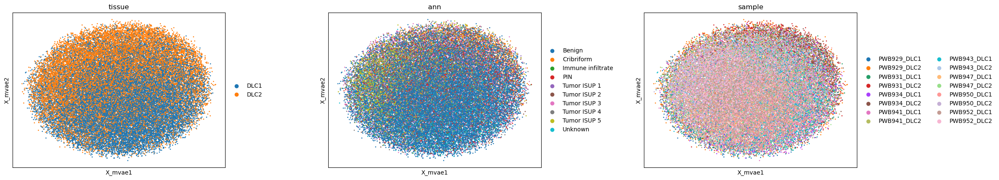

In [154]:
plot_embedding(model, mdata, train_params=train_params, poe_only=False)

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


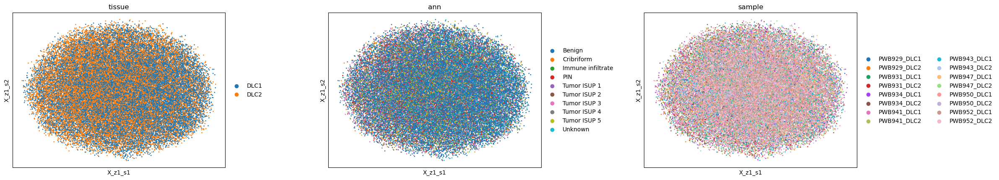

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


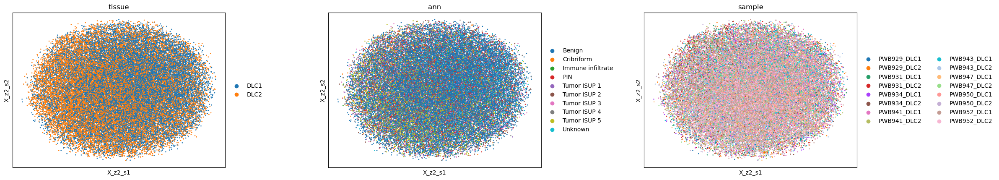

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


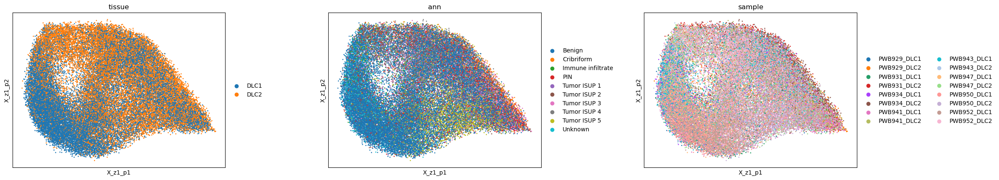

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


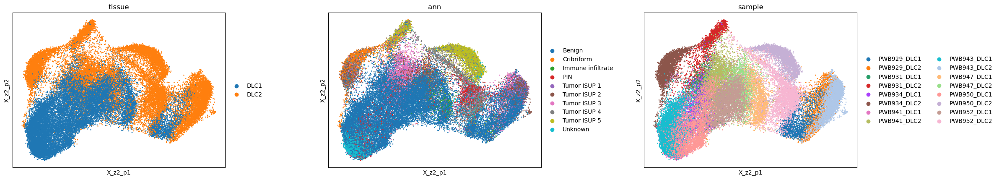

In [155]:
for layer in ["X_z1_s", "X_z2_s", "X_z1_p", "X_z2_p"]:
    sc.pl.embedding(
            mdata,
            layer,
            color=["tissue", "ann", "sample"],
            size=15,
            wspace=0.35,
        )

In [161]:
class_perf = {}
for sample in mdata.obs["sample"].unique():
    class_perf[sample] = classification_performance(mdata, loo=sample, embed_key="X_z2_p")[0]
class_perf

{'PWB929_DLC2': 0.2219178082191781,
 'PWB929_DLC1': 0.41872427983539096,
 'PWB931_DLC2': 0.3121047877145438,
 'PWB931_DLC1': 0.8429268292682927,
 'PWB934_DLC2': 0.06857896472139796,
 'PWB934_DLC1': 0.8907198612315698,
 'PWB941_DLC2': 0.08489483747609942,
 'PWB941_DLC1': 0.30322791000978155,
 'PWB943_DLC2': 0.0994991652754591,
 'PWB943_DLC1': 0.5275039745627981,
 'PWB947_DLC2': 0.39386503067484663,
 'PWB947_DLC1': 0.4235127478753541,
 'PWB950_DLC2': 0.08246753246753247,
 'PWB950_DLC1': 0.7117731514716439,
 'PWB952_DLC2': 0.1077254539858418,
 'PWB952_DLC1': 0.8203967977723634}

## VAE with no LISI

In [24]:
train_params = TrainParams(add_lisi_loss=False, train_size=0.8, n_epochs=100, learning_rate=1e-4, batch_size=128, params_file="smvae_prostate_nolisi")
model_params = ModelParams(beta=0.01, n_layers=2, z_dim=100, n_hidden=30, use_cuda=True)
torch.set_num_threads(16)
model = SMVAE(mdata, model_params)

(42475, 18950)
(42475, 12510)


In [ ]:
train_smvae(model, mdata, "sample", train_params)

Train data size: 33980
Test data size: 8495


100%|██████████████████████████████████████████████████████████████████████| 266/266 [01:05<00:00,  4.08it/s]

EarlyStopping (epoch: 1): train loss improved to 0.10612410483043147



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:17<00:00,  3.82it/s]

EarlyStopping (epoch: 1): valid loss improved to 12.220291208865037



100%|██████████████████████████████████████████████████████████████████████| 266/266 [01:05<00:00,  4.03it/s]

EarlyStopping (epoch: 2): train loss improved to 0.08557787965928336



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:17<00:00,  3.87it/s]

EarlyStopping (epoch: 2): valid loss improved to 8.820881829332949



100%|██████████████████████████████████████████████████████████████████████| 266/266 [01:03<00:00,  4.19it/s]

EarlyStopping (epoch: 3): train loss improved to 0.061559373410467966



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:17<00:00,  3.89it/s]

EarlyStopping (epoch: 3): valid loss improved to 6.4774129710980315



100%|██████████████████████████████████████████████████████████████████████| 266/266 [01:03<00:00,  4.21it/s]

EarlyStopping (epoch: 4): train loss improved to 0.04436898130469634



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:15<00:00,  4.29it/s]

EarlyStopping (epoch: 4): valid loss improved to 4.818553867624767



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:16<00:00,  4.15it/s]

EarlyStopping (epoch: 5): valid loss improved to 3.9741214104552767



100%|██████████████████████████████████████████████████████████████████████| 266/266 [01:05<00:00,  4.08it/s]

EarlyStopping (epoch: 6): train loss improved to 0.02972672538521572



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:17<00:00,  3.79it/s]

EarlyStopping (epoch: 6): valid loss improved to 3.4850910599551983



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:17<00:00,  3.72it/s]

EarlyStopping (epoch: 7): valid loss improved to 3.128556198148585



 64%|██████████████████████████████████████████████▏                         | 43/67 [00:11<00:06,  3.94it/s]

100%|██████████████████████████████████████████████████████████████████████| 332/332 [00:30<00:00, 11.04it/s]
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


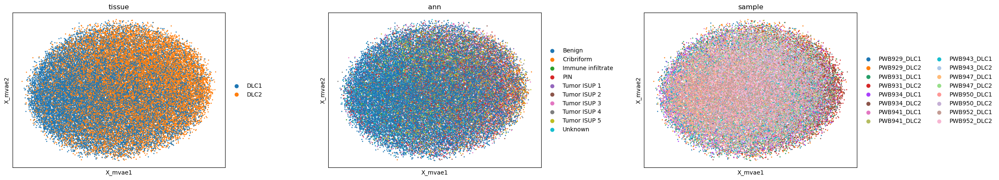

In [92]:
plot_embedding(model, mdata, train_params=train_params, poe_only=False)

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


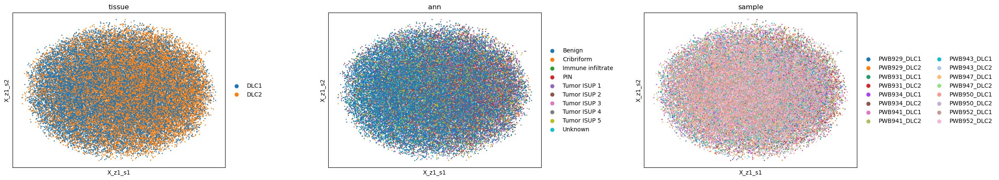

In [103]:
for layer in ["X_z1_s", "X_z2_s", "X_z1_p", "X_z2_p"]:
    sc.pl.embedding(
            mdata,
            layer,
            color=["tissue", "ann", "sample"],
            size=15,
            wspace=0.35,
        )

In [33]:
class_perf = {}
for sample in mdata.obs["sample"].unique():
    class_perf[sample] = classification_performance(mdata, loo=sample)[0]
class_perf

{'PWB929_DLC2': (0.2101761252446184, RandomForestClassifier()),
 'PWB929_DLC1': (0.7757201646090535, RandomForestClassifier()),
 'PWB931_DLC2': (0.23396567299006324, RandomForestClassifier()),
 'PWB931_DLC1': (0.6843902439024391, RandomForestClassifier()),
 'PWB934_DLC2': (0.05901747444774151, RandomForestClassifier()),
 'PWB934_DLC1': (0.7593235039028621, RandomForestClassifier()),
 'PWB941_DLC2': (0.08030592734225621, RandomForestClassifier()),
 'PWB941_DLC1': (0.3557222041082491, RandomForestClassifier()),
 'PWB943_DLC2': (0.41569282136894825, RandomForestClassifier()),
 'PWB943_DLC1': (0.536724960254372, RandomForestClassifier()),
 'PWB947_DLC2': (0.36155419222903884, RandomForestClassifier()),
 'PWB947_DLC1': (0.7337110481586402, RandomForestClassifier()),
 'PWB950_DLC2': (0.023051948051948053, RandomForestClassifier()),
 'PWB950_DLC1': (0.7451543431442929, RandomForestClassifier()),
 'PWB952_DLC2': (0.12742382271468145, RandomForestClassifier()),
 'PWB952_DLC1': (0.75774451792551

/tmp/ipykernel_2140557/3570896479.py:6: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(labels=ax.get_xticklabels(), rotation=90)


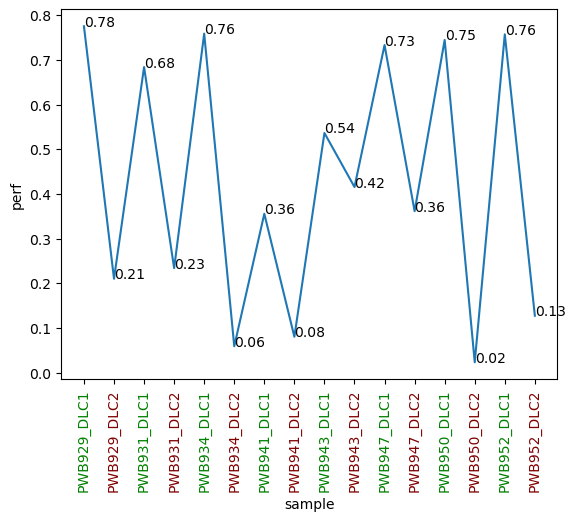

In [90]:
import seaborn as sns
cp = pd.DataFrame({"perf": class_perf.values(), "sample": class_perf.keys()}).sort_values("sample")
cp["tissue"] = ["normal", "cancer"] * int(len(cp) / 2)
ax = sns.lineplot(x="sample", y="perf", data=cp, markers=True)

ax.set_xticklabels(labels=ax.get_xticklabels(), rotation=90)
for tissue, tick_label in zip(cp["tissue"], ax.axes.get_xticklabels()):
    if tissue == "cancer":
        tick_label.set_color("maroon")
    else:
        tick_label.set_color("green")

for x,y in cp[['sample','perf']].values:
    ax.text(x, y, str(round(y, 2)))


In [170]:
# display perf for both
vae_lisi = {'PWB929_DLC2': 0.2172211350293542,
 'PWB929_DLC1': 0.7880658436213992,
 'PWB931_DLC2': 0.2755194218608853,
 'PWB931_DLC1': 0.7409756097560976,
 'PWB934_DLC2': 0.07945928123969667,
 'PWB934_DLC1': 0.8178664353859497,
 'PWB941_DLC2': 0.08948374760994264,
 'PWB941_DLC1': 0.3870231496576459,
 'PWB943_DLC2': 0.467779632721202,
 'PWB943_DLC1': 0.5710651828298887,
 'PWB947_DLC2': 0.36114519427402864,
 'PWB947_DLC1': 0.6728045325779037,
 'PWB950_DLC2': 0.03149350649350649,
 'PWB950_DLC1': 0.7767408470926059,
 'PWB952_DLC2': 0.1298861188057864,
 'PWB952_DLC1': 0.8297946397493908}

vae_no_lisi = {'PWB929_DLC2': 0.2101761252446184,
 'PWB929_DLC1': 0.7757201646090535,
 'PWB931_DLC2': 0.23396567299006324,
 'PWB931_DLC1': 0.6843902439024391,
 'PWB934_DLC2': 0.05901747444774151,
 'PWB934_DLC1': 0.7593235039028621,
 'PWB941_DLC2': 0.08030592734225621, 
 'PWB941_DLC1': 0.3557222041082491, 
 'PWB943_DLC2': 0.41569282136894825, 
 'PWB943_DLC1': 0.536724960254372, 
 'PWB947_DLC2': 0.36155419222903884, 
 'PWB947_DLC1': 0.7337110481586402, 
 'PWB950_DLC2': 0.023051948051948053, 
 'PWB950_DLC1': 0.7451543431442929, 
 'PWB952_DLC2': 0.12742382271468145, 
 'PWB952_DLC1': 0.7577445179255134}
vae_lisi_msi_p = {'PWB929_DLC2': 0.2070450097847358,
 'PWB929_DLC1': 0.7860082304526749,
 'PWB931_DLC2': 0.24299909665763325,
 'PWB931_DLC1': 0.7141463414634146,
 'PWB934_DLC2': 0.06297395318166832,
 'PWB934_DLC1': 0.7528187337380746,
 'PWB941_DLC2': 0.07418738049713193,
 'PWB941_DLC1': 0.35148353439843494,
 'PWB943_DLC2': 0.4464106844741235,
 'PWB943_DLC1': 0.534181240063593,
 'PWB947_DLC2': 0.3492842535787321,
 'PWB947_DLC1': 0.7034938621340887,
 'PWB950_DLC2': 0.021753246753246754,
 'PWB950_DLC1': 0.741564967695621,
 'PWB952_DLC2': 0.12927054478301014,
 'PWB952_DLC1': 0.7713191785589976}
vae_lisi_msi_p_from_msi = {'PWB929_DLC2': 0.2219178082191781,
 'PWB929_DLC1': 0.41872427983539096,
 'PWB931_DLC2': 0.3121047877145438,
 'PWB931_DLC1': 0.8429268292682927,
 'PWB934_DLC2': 0.06857896472139796,
 'PWB934_DLC1': 0.8907198612315698,
 'PWB941_DLC2': 0.08489483747609942,
 'PWB941_DLC1': 0.30322791000978155,
 'PWB943_DLC2': 0.0994991652754591,
 'PWB943_DLC1': 0.5275039745627981,
 'PWB947_DLC2': 0.39386503067484663,
 'PWB947_DLC1': 0.4235127478753541,
 'PWB950_DLC2': 0.08246753246753247,
 'PWB950_DLC1': 0.7117731514716439,
 'PWB952_DLC2': 0.1077254539858418,
 'PWB952_DLC1': 0.8203967977723634}
vae_lisi_rna_p_from_rna = {'PWB929_DLC2': 0.25870841487279844,
 'PWB929_DLC1': 0.8544238683127572,
 'PWB931_DLC2': 0.3062330623306233,
 'PWB931_DLC1': 0.7302439024390244,
 'PWB934_DLC2': 0.10913287174414771,
 'PWB934_DLC1': 0.8633998265394622,
 'PWB941_DLC2': 0.12504780114722752,
 'PWB941_DLC1': 0.3524616889468536,
 'PWB943_DLC2': 0.47111853088480804,
 'PWB943_DLC1': 0.5809220985691574,
 'PWB947_DLC2': 0.3554192229038855,
 'PWB947_DLC1': 0.7568460812086875,
 'PWB950_DLC2': 0.019805194805194805,
 'PWB950_DLC1': 0.8061737257717158,
 'PWB952_DLC2': 0.13665743305632502,
 'PWB952_DLC1': 0.8381482770623042}

In [172]:
cp = pd.DataFrame({"with LISI": vae_lisi, "no LISI": vae_no_lisi, "LISI on MSI p": vae_lisi_msi_p, "from MSI": vae_lisi_msi_p_from_msi, "from RNA": vae_lisi_rna_p_from_rna})
cp["sample"] = cp.index
cp["tissue"] = np.where(cp['sample'].str.endswith("2"), 'cancer', 'normal')
cp

,with LISI,no LISI,LISI on MSI p,from MSI,from RNA,sample,tissue
PWB929_DLC2,0.217221,0.210176,0.207045,0.221918,0.258708,PWB929_DLC2,cancer
PWB929_DLC1,0.788066,0.775720,0.786008,0.418724,0.854424,PWB929_DLC1,normal
PWB931_DLC2,0.275519,0.233966,0.242999,0.312105,0.306233,PWB931_DLC2,cancer
PWB931_DLC1,0.740976,0.684390,0.714146,0.842927,0.730244,PWB931_DLC1,normal
PWB934_DLC2,0.079459,0.059017,0.062974,0.068579,0.109133,PWB934_DLC2,cancer
PWB934_DLC1,0.817866,0.759324,0.752819,0.890720,0.863400,PWB934_DLC1,normal
PWB941_DLC2,0.089484,0.080306,0.074187,0.084895,0.125048,PWB941_DLC2,cancer
PWB941_DLC1,0.387023,0.355722,0.351484,0.303228,0.352462,PWB941_DLC1,normal
PWB943_DLC2,0.467780,0.415693,0.446411,0.099499,0.471119,PWB943_DLC2,cancer
PWB943_DLC1,0.571065,0.536725,0.534181,0.527504,0.580922,PWB943_DLC1,normal


/tmp/ipykernel_2140557/1467567335.py:2: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(labels=ax.get_xticklabels(), rotation=90)


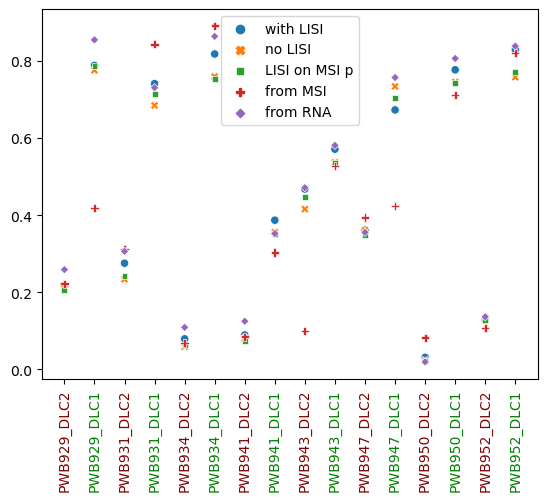

In [174]:
ax = sns.scatterplot(cp, markers=True)
ax.set_xticklabels(labels=ax.get_xticklabels(), rotation=90)
for tissue, tick_label in zip(cp["tissue"], ax.axes.get_xticklabels()):
    if tissue == "cancer":
        tick_label.set_color("maroon")
    else:
        tick_label.set_color("green")

# for model in ["with LISI", "no LISI"]:
#     for x,y in cp[['sample', model]].values:
#         ax.text(x, y, str(round(y, 2)))

In [173]:
cp.groupby("tissue").mean()

/tmp/ipykernel_2140557/1206791820.py:1: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  cp.groupby("tissue").mean()


,with LISI,no LISI,LISI on MSI p,from MSI,from RNA
tissue,,,,,
cancer,0.206499,0.188898,0.191741,0.171382,0.222765
normal,0.698042,0.668561,0.669377,0.617348,0.722827


### Classification perf on new annotations

In [ ]:
vae_with_lisi = {'PWB929_DLC2': 0.1401174168297456,
 'PWB929_DLC1': 0.45113168724279834,
 'PWB931_DLC2': 0.1987353206865402,
 'PWB931_DLC1': 0.3439024390243902,
 'PWB934_DLC2': 0.11045169798878998,
 'PWB934_DLC1': 0.513009540329575,
 'PWB941_DLC2': 0.16864244741873805,
 'PWB941_DLC1': 0.4147375285295077,
 'PWB943_DLC2': 0.17028380634390652,
 'PWB943_DLC1': 0.4998410174880763,
 'PWB947_DLC2': 0.22535787321063394,
 'PWB947_DLC1': 0.3602455146364495,
 'PWB950_DLC2': 0.10227272727272728,
 'PWB950_DLC1': 0.5312275664034458,
 'PWB952_DLC2': 0.17174515235457063,
 'PWB952_DLC1': 0.40306300034806825}